###### Hotel Recommendation System - Expedia
Data Source - https://www.kaggle.com/c/expedia-hotel-recommendations/data

In [1]:
import pandas as pd
import pandas_profiling as pp
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np
import warnings
from datetime import datetime
from sklearn import svm
from sklearn.model_selection import cross_val_score
from sklearn.pipeline import make_pipeline
from sklearn import preprocessing
from sklearn.naive_bayes import GaussianNB
from sklearn.preprocessing import StandardScaler
from sklearn.neighbors import KNeighborsClassifier
%matplotlib inline
warnings.simplefilter('ignore')

In [2]:
# loading data
destination_df = pd.read_csv('expedia-hotel-recommendations/destinations.csv', nrows=100000)
train_df = pd.read_csv('expedia-hotel-recommendations/train.csv', nrows = 100000)

In [3]:
train_df.head()

,date_time,site_name,posa_continent,user_location_country,user_location_region,user_location_city,orig_destination_distance,user_id,is_mobile,is_package,...,srch_children_cnt,srch_rm_cnt,srch_destination_id,srch_destination_type_id,is_booking,cnt,hotel_continent,hotel_country,hotel_market,hotel_cluster
0,2014-08-11 07:46:59,2,3,66,348,48862,2234.2641,12,0,1,...,0,1,8250,1,0,3,2,50,628,1
1,2014-08-11 08:22:12,2,3,66,348,48862,2234.2641,12,0,1,...,0,1,8250,1,1,1,2,50,628,1
2,2014-08-11 08:24:33,2,3,66,348,48862,2234.2641,12,0,0,...,0,1,8250,1,0,1,2,50,628,1
3,2014-08-09 18:05:16,2,3,66,442,35390,913.1932,93,0,0,...,0,1,14984,1,0,1,2,50,1457,80
4,2014-08-09 18:08:18,2,3,66,442,35390,913.6259,93,0,0,...,0,1,14984,1,0,1,2,50,1457,21


In [4]:
train_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 100000 entries, 0 to 99999
Data columns (total 24 columns):
 #   Column                     Non-Null Count   Dtype  
---  ------                     --------------   -----  
 0   date_time                  100000 non-null  object 
 1   site_name                  100000 non-null  int64  
 2   posa_continent             100000 non-null  int64  
 3   user_location_country      100000 non-null  int64  
 4   user_location_region       100000 non-null  int64  
 5   user_location_city         100000 non-null  int64  
 6   orig_destination_distance  63078 non-null   float64
 7   user_id                    100000 non-null  int64  
 8   is_mobile                  100000 non-null  int64  
 9   is_package                 100000 non-null  int64  
 10  channel                    100000 non-null  int64  
 11  srch_ci                    99929 non-null   object 
 12  srch_co                    99929 non-null   object 
 13  srch_adults_cnt            100

In [5]:
train_df.describe()

,site_name,posa_continent,user_location_country,user_location_region,user_location_city,orig_destination_distance,user_id,is_mobile,is_package,channel,...,srch_children_cnt,srch_rm_cnt,srch_destination_id,srch_destination_type_id,is_booking,cnt,hotel_continent,hotel_country,hotel_market,hotel_cluster
count,100000.00000,100000.000000,100000.000000,100000.000000,100000.000000,63078.000000,100000.000000,100000.000000,100000.000000,100000.000000,...,100000.000000,100000.000000,100000.000000,100000.000000,100000.00000,100000.000000,100000.000000,100000.000000,100000.000000,100000.00000
mean,9.10014,2.637850,84.531040,311.630930,28465.223540,1897.609161,195700.878390,0.138030,0.260470,5.760540,...,0.325160,1.112700,14511.034340,2.590540,0.08270,1.477770,3.206530,80.972620,597.559610,49.74576
std,12.09091,0.751001,54.320574,209.399151,16822.922817,2123.885180,110173.879786,0.344933,0.438893,3.771156,...,0.722341,0.441928,11043.082364,2.160456,0.27543,1.197163,1.624119,55.679861,507.624672,28.95063
min,2.00000,0.000000,0.000000,0.000000,3.000000,0.005600,12.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,8.000000,1.000000,0.00000,1.000000,0.000000,0.000000,0.000000,0.00000
25%,2.00000,3.000000,66.000000,174.000000,13914.000000,290.528875,107548.000000,0.000000,0.000000,2.000000,...,0.000000,1.000000,8267.000000,1.000000,0.00000,1.000000,2.000000,50.000000,160.000000,25.00000
50%,2.00000,3.000000,66.000000,311.000000,27733.000000,1093.888450,181983.000000,0.000000,0.000000,9.000000,...,0.000000,1.000000,11271.000000,1.000000,0.00000,1.000000,2.000000,50.000000,585.000000,49.00000
75%,11.00000,3.000000,69.000000,385.000000,43113.000000,2518.177400,301357.000000,0.000000,1.000000,9.000000,...,0.000000,1.000000,18881.000000,5.000000,0.00000,2.000000,4.000000,106.000000,701.000000,73.00000
max,53.00000,4.000000,239.000000,1025.000000,56495.000000,11641.224200,391007.000000,1.000000,1.000000,10.000000,...,9.000000,8.000000,65035.000000,9.000000,1.00000,59.000000,6.000000,212.000000,2117.000000,99.00000


In [6]:
# EDA Train data
pp.ProfileReport(train_df)

In [7]:
# Lets check for Nulls
train_df.isnull().any()

date_time                    False
site_name                    False
posa_continent               False
user_location_country        False
user_location_region         False
user_location_city           False
orig_destination_distance     True
user_id                      False
is_mobile                    False
is_package                   False
channel                      False
srch_ci                       True
srch_co                       True
srch_adults_cnt              False
srch_children_cnt            False
srch_rm_cnt                  False
srch_destination_id          False
srch_destination_type_id     False
is_booking                   False
cnt                          False
hotel_continent              False
hotel_country                False
hotel_market                 False
hotel_cluster                False
dtype: bool

###### Data Preprocessing
The first step is to clean and pre-process the data and perform exploratory analysis to get some interesting insights into the process of choosing a hotel.

Remove the users who did not booked the hotel
Identify the searches by each user belonging to a specific type of destination
orig_destination_distance contains Nan values
The check-in and check-out dates to find the duration of the stay for each of the entries in the training set.

<AxesSubplot:>

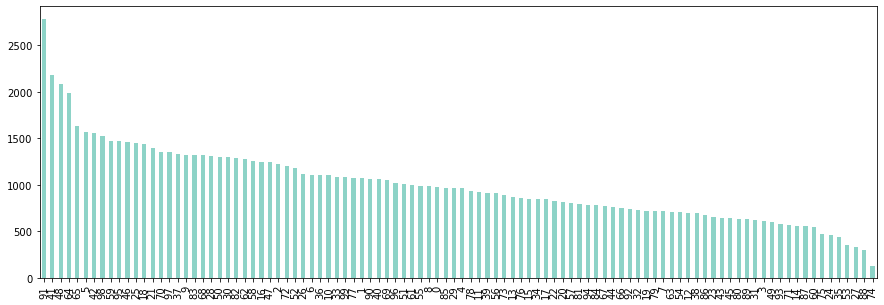

In [8]:
# Plot frequency for each hotel_clusters
train_df["hotel_cluster"].value_counts().plot(kind='bar',colormap="Set3",figsize=(15,5))

<AxesSubplot:xlabel='hotel_cluster', ylabel='Density'>

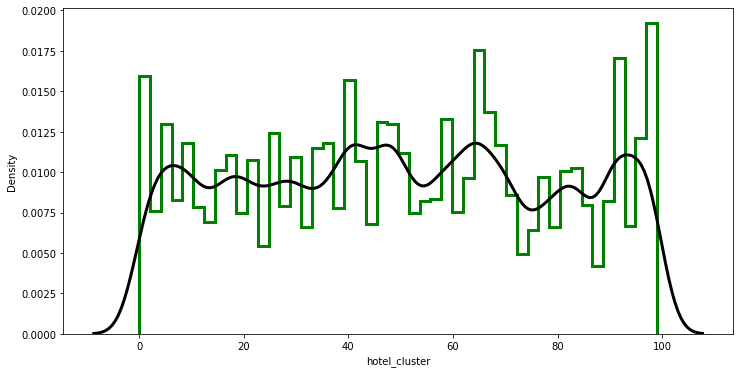

In [9]:
# histogram of clusters
plt.figure(figsize=(12, 6))
sns.distplot(train_df['hotel_cluster'], rug_kws={"color": "g"},
            kde_kws={"color": "k", "lw": 3, "label": "KDE"},
            hist_kws={"histtype": "step", "linewidth": 3,
                       "alpha": 1, "color": "g"})

The hotel clusters histogram tells us that the data is well distributed over all the 100 clusters and there is skewness in the data.

Feature Engineering
The following date columns can not be used directly in the model. Therefore I will extract year and month from them.
date_time - Timestamp
srch_ci - Checkin date
srch_co - Checkout date

In [10]:
# get year part from a date
def get_year(x):
    if x is not None and type(x) is not float:
        try:
            return datetime.strptime(x, '%Y-%m-%d').year
        except ValueError:
            return datetime.strptime(x, '%Y-%m-%d %H:%M:%S').year
    else:
        return 2013
    pass

# get month part from a date
def get_month(x):
    if x is not None and type(x) is not float:
        try:
            return datetime.strptime(x, '%Y-%m-%d').month
        except:
            return datetime.strptime(x, '%Y-%m-%d %H:%M:%S').month
    else:
        return 1
    pass

# extract year and month from date time column
train_df['date_time_year'] = pd.Series(train_df.date_time, index = train_df.index)
train_df['date_time_month'] = pd.Series(train_df.date_time, index = train_df.index)

train_df.date_time_year = train_df.date_time_year.apply(lambda x: get_year(x))
train_df.date_time_month = train_df.date_time_month.apply(lambda x: get_month(x))
del train_df['date_time']

# extract year and month from check in date column
train_df['srch_ci_year'] = pd.Series(train_df.srch_ci, index = train_df.index)
train_df['srch_ci_month'] = pd.Series(train_df.srch_ci, index = train_df.index)

train_df.srch_ci_year = train_df.srch_ci_year.apply(lambda x: get_year(x))
train_df.srch_ci_month = train_df.srch_ci_month.apply(lambda x: get_month(x))
del train_df['srch_ci']

# extract year and month from check out date column
train_df['srch_co_year'] = pd.Series(train_df.srch_co, index = train_df.index)
train_df['srch_co_month'] = pd.Series(train_df.srch_co, index = train_df.index)

train_df.srch_co_year = train_df.srch_co_year.apply(lambda x: get_year(x))
train_df.srch_co_month = train_df.srch_co_month.apply(lambda x: get_month(x))
del train_df['srch_co']

# check the transformed data
train_df.head()

,site_name,posa_continent,user_location_country,user_location_region,user_location_city,orig_destination_distance,user_id,is_mobile,is_package,channel,...,hotel_continent,hotel_country,hotel_market,hotel_cluster,date_time_year,date_time_month,srch_ci_year,srch_ci_month,srch_co_year,srch_co_month
0,2,3,66,348,48862,2234.2641,12,0,1,9,...,2,50,628,1,2014,8,2014,8,2014,8
1,2,3,66,348,48862,2234.2641,12,0,1,9,...,2,50,628,1,2014,8,2014,8,2014,9
2,2,3,66,348,48862,2234.2641,12,0,0,9,...,2,50,628,1,2014,8,2014,8,2014,9
3,2,3,66,442,35390,913.1932,93,0,0,3,...,2,50,1457,80,2014,8,2014,11,2014,11
4,2,3,66,442,35390,913.6259,93,0,0,3,...,2,50,1457,21,2014,8,2014,11,2014,11


<AxesSubplot:>

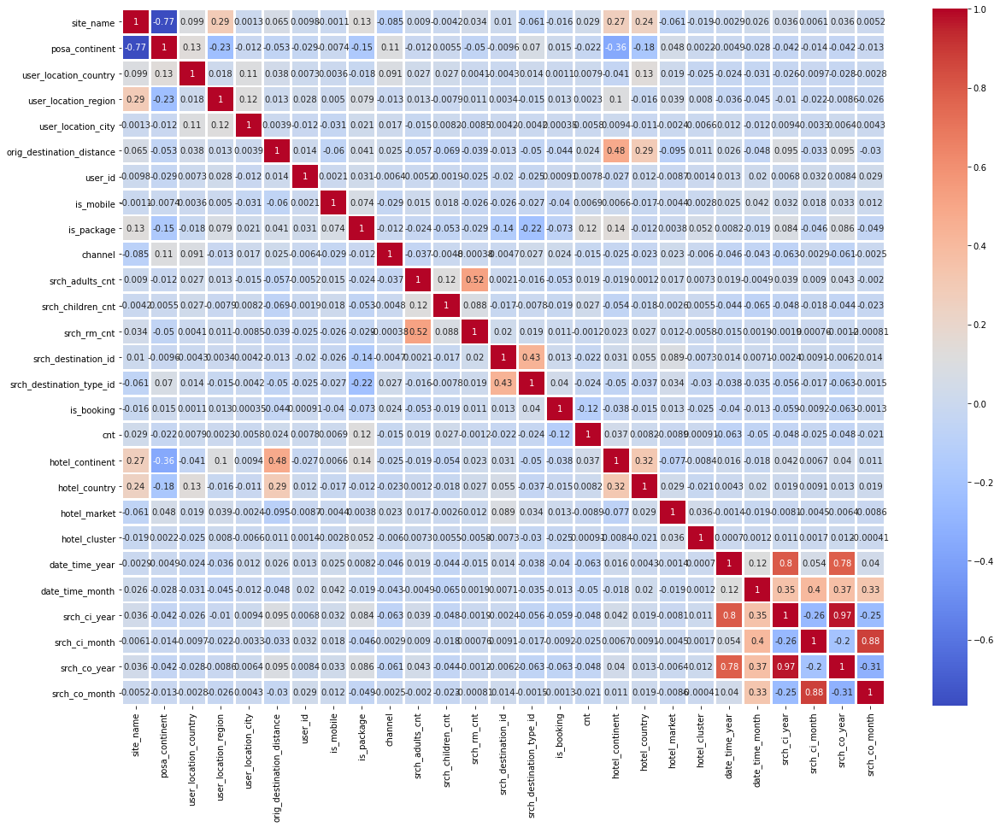

In [11]:
# heatmap
fig, ax = plt.subplots()
fig.set_size_inches(20, 15)
sns.heatmap(train_df.corr(),cmap='coolwarm',ax=ax,annot=True,linewidths=2)

Lets look at correlation of hotel_cluster with other attributes

In [12]:
train_df.corr()["hotel_cluster"].sort_values()

srch_destination_type_id    -0.030064
is_booking                  -0.025380
user_location_country       -0.025170
hotel_country               -0.021170
site_name                   -0.019154
hotel_continent             -0.008441
srch_destination_id         -0.007258
user_location_city          -0.006580
channel                     -0.005956
srch_rm_cnt                 -0.005801
is_mobile                   -0.002803
srch_co_month               -0.000413
date_time_year               0.000696
cnt                          0.000914
date_time_month              0.001208
user_id                      0.001396
srch_ci_month                0.001682
posa_continent               0.002204
srch_children_cnt            0.005469
srch_adults_cnt              0.007322
user_location_region         0.008037
srch_ci_year                 0.010879
orig_destination_distance    0.011362
srch_co_year                 0.012014
hotel_market                 0.036107
is_package                   0.051955
hotel_cluste

There is no strong relationship between hotel cluster and other variables, hence methods which model linear relationship between features might not be suitable for the problem.

I explored few EDAs from the competition, and based on the details, I assume the following factors will be impactful when it comes to clustering.
srch_destination_id - ID of the destination where the hotel search was performed
hotel_country - Country where the hotel is located
hotel_market - Hotel market
hotel_cluster - ID of a hotel cluster
is_package - Whether part of a package or not (1/0)
is_booking - Booking (1) or Click (0)

Since we are only interested in booking events, let us get rid of clicks.

In [13]:
train_booking = train_df.loc[train_df['is_booking'] == 1]

Create a pivot to map each cluster, and shape it accordingly so that it can be merged with the original data.

In [14]:
factors = [train_booking.groupby(['srch_destination_id','hotel_country','hotel_market','is_package','hotel_cluster'])['is_booking'].agg(['sum','count'])]
sum1 = pd.concat(factors).groupby(level=[0,1,2,3,4]).sum()
sum1.dropna(inplace=True)
sum1.head(10)

sum  \
srch_destination_id hotel_country hotel_market is_package hotel_cluster        
8                   50            416          0          32               1   
                                                          77               1   
11                  50            824          0          94               1   
14                  27            1434         0          20               1   
16                  50            419          0          7                1   
21                  77            1454         1          44               1   
                                                          46               1   
24                  50            606          0          32               2   
                                                          94               1   
25                  50            945          0          48               1   

                                                                         count  
srch_destination_id hotel_country hotel_market is_package hotel_cluster         
8                   50            416          0          32                 1  
                                                          77                 1  
11                  50            824          0          94                 1  
14                  27            1434         0          20                 1  
16                  50            419          0          7                  1  
21                  77            1454         1          44                 1  
                                                          46                 1  
24                  50            606          0          32                 2  
                                                          94                 1  
25                  50            945          0          48                 1

In [15]:
sum1['sum_and_cnt'] = 0.85*sum1['sum'] + 0.15*sum1['count']
sum1 = sum1.groupby(level=[0,1,2,3]).apply(lambda x: x.astype(float)/x.sum())
sum1.reset_index(inplace=True)
sum1.head()

,srch_destination_id,hotel_country,hotel_market,is_package,hotel_cluster,sum,count,sum_and_cnt
0,8,50,416,0,32,0.5,0.5,0.5
1,8,50,416,0,77,0.5,0.5,0.5
2,11,50,824,0,94,1.0,1.0,1.0
3,14,27,1434,0,20,1.0,1.0,1.0
4,16,50,419,0,7,1.0,1.0,1.0


In [16]:
sum_pivot = sum1.pivot_table(index=['srch_destination_id','hotel_country','hotel_market','is_package'], columns='hotel_cluster', values='sum_and_cnt').reset_index()
sum_pivot.head()

hotel_cluster,srch_destination_id,hotel_country,hotel_market,is_package,0,1,2,3,4,5,...,90,91,92,93,94,95,96,97,98,99
0,8,50,416,0,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,11,50,824,0,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,1.0,NaN,NaN,NaN,NaN,NaN
2,14,27,1434,0,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,16,50,419,0,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,21,77,1454,1,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


Quickly check the destination data to determine the relationship with other data.


In [17]:
destination_df.head()

,srch_destination_id,d1,d2,d3,d4,d5,d6,d7,d8,d9,...,d140,d141,d142,d143,d144,d145,d146,d147,d148,d149
0,0,-2.198657,-2.198657,-2.198657,-2.198657,-2.198657,-1.897627,-2.198657,-2.198657,-1.897627,...,-2.198657,-2.198657,-2.198657,-2.198657,-2.198657,-2.198657,-2.198657,-2.198657,-2.198657,-2.198657
1,1,-2.181690,-2.181690,-2.181690,-2.082564,-2.181690,-2.165028,-2.181690,-2.181690,-2.031597,...,-2.165028,-2.181690,-2.165028,-2.181690,-2.181690,-2.165028,-2.181690,-2.181690,-2.181690,-2.181690
2,2,-2.183490,-2.224164,-2.224164,-2.189562,-2.105819,-2.075407,-2.224164,-2.118483,-2.140393,...,-2.224164,-2.224164,-2.196379,-2.224164,-2.192009,-2.224164,-2.224164,-2.224164,-2.224164,-2.057548
3,3,-2.177409,-2.177409,-2.177409,-2.177409,-2.177409,-2.115485,-2.177409,-2.177409,-2.177409,...,-2.161081,-2.177409,-2.177409,-2.177409,-2.177409,-2.177409,-2.177409,-2.177409,-2.177409,-2.177409
4,4,-2.189562,-2.187783,-2.194008,-2.171153,-2.152303,-2.056618,-2.194008,-2.194008,-2.145911,...,-2.187356,-2.194008,-2.191779,-2.194008,-2.194008,-2.185161,-2.194008,-2.194008,-2.194008,-2.188037


Merge the filtered booking data, pivotted data and destination data to form a single wide dataset.

In [18]:
train_booking = pd.merge(train_booking, destination_df, how='left', on='srch_destination_id')
train_booking = pd.merge(train_booking, sum_pivot, how='left', on=['srch_destination_id','hotel_country','hotel_market','is_package'])
train_booking.fillna(0, inplace=True)
train_booking.shape

(8270, 276)

In [19]:
train_booking.head()

,site_name,posa_continent,user_location_country,user_location_region,user_location_city,orig_destination_distance,user_id,is_mobile,is_package,channel,...,90,91,92,93,94,95,96,97,98,99
0,2,3,66,348,48862,2234.2641,12,0,1,9,...,0.0,0.017857,0.0,0.0,0.0,0.000000,0.0,0.0,0.000000,0.0
1,2,3,66,318,52078,0.0000,756,0,1,4,...,0.0,0.071429,0.0,0.0,0.0,0.071429,0.0,0.0,0.071429,0.0
2,30,4,195,548,56440,0.0000,1048,0,1,9,...,0.0,0.000000,0.0,0.0,0.0,0.000000,0.0,0.0,0.000000,0.0
3,30,4,195,991,47725,0.0000,1048,0,0,9,...,0.0,0.000000,0.0,0.0,0.0,0.000000,0.0,0.0,0.000000,0.0
4,2,3,66,462,41898,2454.8588,1482,0,1,1,...,0.0,0.000000,0.0,0.0,0.0,0.750000,0.0,0.0,0.000000,0.0


First, let us separate the target variable and predicter variables.


In [20]:
X = train_booking.drop(['user_id', 'hotel_cluster', 'is_booking'], axis=1)
y = train_booking.hotel_cluster
X.shape, y.shape

((8270, 273), (8270,))

Check if all of the 100 clusters are present in the training data.

In [21]:
y.nunique()

100

###### Naive Bayes classifier

In [22]:
classifier = make_pipeline(preprocessing.StandardScaler(), GaussianNB(priors=None))
np.mean(cross_val_score(classifier, X, y, cv=10))

0.08742442563482468

###### K-Nearest Neighbor classifier

In [23]:
classifier = make_pipeline(preprocessing.StandardScaler(), KNeighborsClassifier(n_neighbors=5))
np.mean(cross_val_score(classifier, X, y, cv=10, scoring='accuracy'))

0.37932285368802904

###### Support Vector Machine (SVM)

In [24]:
classifier = make_pipeline(preprocessing.StandardScaler(), svm.SVC(decision_function_shape='ovo'))
np.mean(cross_val_score(classifier, X, y, cv=10))

0.4385731559854896

SVM performed the best among the 3 algorithms.Yet the corss validation score is only 0.43. Further feature engineering and increasing the number of folds might help improving the score.

The algorithms were chosen based on the understanding of the data from the EDA and preliminary analysis. Here are the basis of the selection.

Naive Bayes classifier I wanted to try Naive Bayes algorithm because it is simple and if the conditional independence assumption actually holds, a it will converge quicker than discriminative models like logistic regression, hence it will need less training data.
But it has the worst performance of the four models. Therefore, this classifier is not recommended for the problem at hand.

Support Vector Machine SVM is capable of doing both classification and regression. Since we are trying to clasify users to hotel clusters, I have chosen SVM. As the clusters are multi level (100), this is using non-linear SVM. Non-linear SVM means that the boundary that the algorithm calculates doesn't have to be a straight line. The benefit is that we can capture much more complex relationships between the datapoints without having to perform difficult transformations on our own. The downside is that the training time is much longer as it's much more computationally intensive.
Using SVM, I have achieved the highest cross validation score.

K-Nearest Neighbor classifier is a non-parametric, lazy learning algorithm. In the currentcontext, the idea is to teach the model which users chose which hotel cluster, and predict future cluster assignment based on that learning.